# Instruções da prova

- Renomear o notebook para C209-PV2-NOME_SOBRENOME_MATRICULA
- Enviar no teams a pasta com todas as mídias zipada com o nome "NOME_SOBRENOME_MATRICULA.zip"

# Parte teórica

Classifique as afirmações em Verdadeiro ou Falso, justifique as afirmativas falsas

1 - Imagens no formato RAW são bastante utilizadas por fotógrafos e tem alta taxa de compressão.

In [1]:
# F -> imagens do tipo RAW tem baixa taxa de compressão

2 - Altura significa o volume do som e intensidade classifica o som como agudo ou grave.

In [ ]:
# V

3 - A quantidade de quadros por segundo (FPS) nos indica quantas imagens são exibidas em um intervalo de um segundo.

In [ ]:
# V

4 - Áudios podem ser representados por uma matriz MxN sendo M o número de amostras e N a quantidade de canais.

In [ ]:
# V

5 - Compressão de dados **com perdas** podem ser revertidos, gerando a imagem original novamente.

In [ ]:
# F -> Compressão com perdas não conseguem gerar a imagem original quando revertidos

6 - Aquivos de áudio com um canal são chamados de stereos.

In [ ]:
# F -> Stereos possuem dois canais

# Parte prática

## Material de apoio

## **Instalar bibliotecas (caso ainda não tenham sido instaladas)**
```
pip install numpy
pip install matplotlib
pip install sounddevice
pip install moviepy
pip install scipy
```

## **Importações**
```
import moviepy.editor as mpe
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
import sounddevice as sd
from PIL import Image
```

### Manipulação de imagens

```
(l,c,p) = img.shape
plt.imshow(imagem)
```

### Forçando uma imagem de uma página para 3 páginas
```
  imagem_3p = np.zeros(shape=(l,c,p),dtype=np.uint8)
  imagem_3p[:,:, 0] = frame_1p
  imagem_3p[:,:, 1] = frame_1p
  imagem_3p[:,:, 2] = frame_1p
```

### Manipulação de vídeo
```
video = mpe.VideoFileClip("video.mp4")
frame = video.get_frame(2 / video.fps)
frame = video.get_frame(2)
video.ipython_display(width=480)
video_modificado = video.fl_image(func_modificar)
subclip = video.subclip(0,2)
subclip = video.subclip(3)
parts = mpe.concatenate_videoclips([part1, part2])
video.write_videofile('video.mp4')
```

### Manipulação de áudio
```
fs, data = wavfile.read("nome.extensão")
sd.play(data, fs)
wavfile.write("nome.extensão", fs, parte)

Recortando dos segundos 5 até 10 ( mais de um canal de audio )
data[fs * 5:fs * 10, :]

Recortando dos segundos 5 até 10 ( com um canal de audio )
data[fs * 5:fs * 10]
```


### Detecção de bordas
```
    imagem_grey = np.average(frame, axis=2).astype(np.float64)
   
    abs_tg_c = np.abs(np.diff(imagem_grey.astype(np.float64), axis=0, append=255))
    abs_tg_l = np.abs(np.diff(imagem_grey.astype(np.float64), axis=1, append=255))
    abs_tg = np.sqrt(abs_tg_c ** 2 + abs_tg_l ** 2)

    imagem_border = np.zeros(shape=(l, c), dtype=np.uint8)
    imagem_border[abs_tg > threshold] = 255
```


### Imagem binária
```
 image_bw = np.average(frame, axis=2).astype(np.float64)
 image_bin = np.zeros(shape=(l,c),dtype=np.uint8)
 image_bin[image_bw > thresh] = 255
```

### Conversão para CMY
```
img_cmy = 255 - img_rgb
```

**1 -** Importe as bibliotecas que serão usadas

In [2]:
import moviepy.editor as mpe            # biblioteca para manipulação de vídeo
import numpy as np                      # biblioteca para usar arrays do numpy
import matplotlib.pyplot as plt         # biblioteca para realiza plots 
from scipy.io import wavfile            # biblioteca para leitura de arquivos de áudio
import sounddevice as sd                # biblioteca para trabalhar com áudio

**2 -** Carregue o áudio **Funky_Town.wav** presente pasta e reproduza-o.

In [3]:
# abrindo o áudio
fs, data = wavfile.read("Funky_Town.wav")

# tocando o áudio
sd.play(data, fs)

**3 -** Recorte o áudio anterior de 7 a 11 segundos e reproduza em seguida.

In [7]:
# recortando o áudio do segundo 7 até o 11
audio_recortado = data[fs * 7:fs * 11]

# reproduzindo o áudio recortado
sd.play(audio_recortado,fs)

**4 -** Reproduza a parte cortada 50% mais agudo

In [4]:
# reproduzindo o áudio recortado 50% mais agudo
sd.play(audio_recortado, fs*1.5)

**5 -** Abra o vídeo "dancing.mp4" e salve-o em uma variável, pegue o **frame do segundo 4** e o exiba.

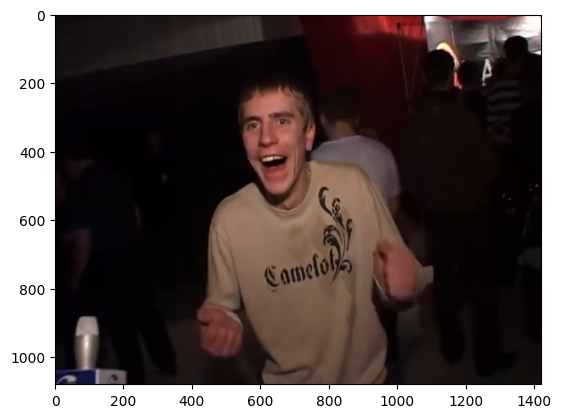

In [8]:
# abrindo o arquivo de vídeo "dancing.mp4"
video = mpe.VideoFileClip("dancing.mp4")

# pegando o frame do segundo 4
frame = video.get_frame(4 / video.fps)

# exibindo o frame que foi pego
plt.imshow(frame)

**6 -** Crie uma função que receba um frame e retorne um frame em binário com **treshold de 82**, aplique essa função no vídeo e observe o resultado. **Sua função deve retornar um frame com 3 páginas para evitar problemas**.

In [25]:
def frame_binario(frame): 

    # pega as linhas, colunas e pixels
    (l,c,p) = frame.shape

    frame_bw = np.average(frame, axis=2).astype(np.float64)

    threshold = 82   # define o threshold

    frame_bin = np.zeros(shape=(l,c), dtype=np.uint8)
    frame_bin[frame_bw > threshold] = 255
    
    frame_3p = np.zeros(shape=(l,c,p),dtype=np.uint8)
    frame_3p[:,:, 0] = frame_bin
    frame_3p[:,:, 1] = frame_bin
    frame_3p[:,:, 2] = frame_bin
        
    return frame_3p     # retorna o vídeo binário

**7 -** Crie uma função que receba um frame e realize a detecção de bordas nele com **treshold de valor 6**, aplique essa função no vídeo e observe o resultado. **Sua função deve retornar um frame com 3 páginas para evitar problemas**.

In [9]:
def deteccao_bordas(frame):

    # pega as linhas, colunas e pixels
    (l,c,p) = frame.shape
    
    frame_bw = np.average(frame, axis=2).astype(np.float64)
    
    abs_tg_c = np.abs(np.diff(frame_bw.astype(np.float64), axis=0, append=255))
    abs_tg_l = np.abs(np.diff(frame_bw.astype(np.float64), axis=1, append=255))
    abs_tg = np.sqrt(abs_tg_c ** 2 + abs_tg_l ** 2)

    threshold = 6   # define o threshold

    frame_border = np.zeros(shape=(l, c), dtype=np.uint8)
    frame_border[abs_tg > threshold] = 255
    
    frame_3p = np.zeros(shape=(l,c,p),dtype=np.uint8)
    frame_3p[:, :, 0] = frame_border
    frame_3p[:, :, 1] = frame_border
    frame_3p[:, :, 2] = frame_border
    
    return frame_3p     # retorna o frame do vídeo com a detecção de bordas aplicada


# chama o metodo que aplica a função frame a frame do vídeo
video_border = video.fl_image(deteccao_bordas)

# plota o vídeo
video_border.ipython_display(width=480)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


***8 -*** Crie uma função que receba um frame e realize a conversão dele para o espaço de cor cmy.

In [10]:
def conversao_cmy(frame):

    # realiza a inverão de cores dos pixels do frame
    cmy = 255 - frame

    return cmy

# chama o metodo que aplica a função frame a frame do vídeo
video_cmy = video.fl_image(conversao_cmy)

# plota o vídeo
video_cmy.ipython_display(width=480)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**9 -** Separe o vídeo original em 3 subclips:
- Segundos ***0 ao 3***: Aplicar conversão para binário
- Segundos ***3 ao 4***: Aplicar detecção de borda
- Segundos ***4 em diante***: Aplicar conversão para cmy

**Una esses clips em um único vídeo e exiba o resultado.**

In [26]:
# separando o vídeo em partes e aplicando a função nos frames da parte recortada
parte1 = video.subclip(0,3).fl_image(frame_binario)
parte2 = video.subclip(3,4).fl_image(deteccao_bordas)
parte3 = video.subclip(4).fl_image(conversao_cmy)

# concatenando as partes dos vídeos que foram separadas
video_final = mpe.concatenate_videoclips([parte1, parte2, parte3])

# plotando o vídeo final
video_final.ipython_display(width=480)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**10 -** Salve o vídeo resultante da última etapa com o nome "resultado_dancing.mp4".

In [27]:
video_final.write_videofile('resultado_dancing.mp4')

Moviepy - Building video resultado_dancing.mp4.
MoviePy - Writing audio in resultado_dancingTEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video resultado_dancing.mp4



Moviepy - Done !
Moviepy - video ready resultado_dancing.mp4
